In [1]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport
from dataprofiler import Profiler

## Read the merged flight weather data

In [2]:
df = pd.read_csv("output/flight_weather_merged.csv")

## Basic Profiling with Pandas

Basic profiling steps include:
* Inspecting basic dataframe characteristics (e.g., rows, columns
* Inspecting inferred datatypes and missing value counts
* Generating summary statistics for each column
* Visualizing distributions

Get the shape of the dataframe (rows, columns):

In [3]:
df.shape

(5022397, 32)

Use the `info()`) method to get an overview of columns, data types, and missing values. Note the initial datatypes determined by Pandas:

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5022397 entries, 0 to 5022396
Data columns (total 32 columns):
 #   Column         Dtype  
---  ------         -----  
 0   YEAR           int64  
 1   FL_DATE        object 
 2   ORIGIN         object 
 3   DEST           object 
 4   CRS_DEP_TIME   int64  
 5   DEP_TIME       float64
 6   CRS_ARR_TIME   int64  
 7   ARR_TIME       float64
 8   WEATHER_DELAY  float64
 9   DEP_HOUR       int64  
 10  DEP_MINUTE     int64  
 11  DEP_DATETIME   object 
 12  origin_temp    float64
 13  dest_temp      float64
 14  origin_dwpt    float64
 15  dest_dwpt      float64
 16  origin_rhum    float64
 17  dest_rhum      float64
 18  origin_prcp    float64
 19  dest_prcp      float64
 20  origin_snow    float64
 21  dest_snow      float64
 22  origin_wdir    float64
 23  dest_wdir      float64
 24  origin_wspd    float64
 25  dest_wspd      float64
 26  origin_wpgt    float64
 27  dest_wpgt      float64
 28  origin_pres    float64
 29  dest_pres     

Inspect the summary statistics (e.g., mean, min, max, etc) for numeric columns:

In [5]:
df.describe()

,YEAR,CRS_DEP_TIME,DEP_TIME,CRS_ARR_TIME,ARR_TIME,WEATHER_DELAY,DEP_HOUR,DEP_MINUTE,origin_temp,dest_temp,...,origin_wdir,dest_wdir,origin_wspd,dest_wspd,origin_wpgt,dest_wpgt,origin_pres,dest_pres,origin_coco,dest_coco
count,5022397.0,5.022397e+06,4.722777e+06,5.022397e+06,4.720398e+06,5.022397e+06,5.022397e+06,5.022397e+06,255325.000000,0.0,...,254905.000000,0.0,255099.000000,0.0,0.0,0.0,253388.000000,0.0,219528.000000,0.0
mean,2020.0,1.315357e+03,1.312706e+03,1.494236e+03,1.480714e+03,4.051159e-01,1.288848e+01,2.650901e+01,13.638210,NaN,...,170.389318,NaN,12.620294,NaN,NaN,NaN,1018.223163,NaN,4.085902,NaN
std,0.0,4.615186e+02,4.669689e+02,4.791379e+02,4.830386e+02,1.046543e+01,4.592544e+00,1.810137e+01,10.070906,NaN,...,109.461435,NaN,8.176904,NaN,NaN,NaN,6.720003,NaN,3.709793,NaN
min,2020.0,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-22.800000,NaN,...,0.000000,NaN,0.000000,NaN,NaN,NaN,978.500000,NaN,1.000000,NaN
25%,2020.0,9.250000e+02,9.240000e+02,1.123000e+03,1.115000e+03,0.000000e+00,9.000000e+00,1.000000e+01,5.600000,NaN,...,80.000000,NaN,7.600000,NaN,NaN,NaN,1014.100000,NaN,2.000000,NaN
50%,2020.0,1.312000e+03,1.313000e+03,1.516000e+03,1.510000e+03,0.000000e+00,1.300000e+01,2.700000e+01,13.300000,NaN,...,180.000000,NaN,11.200000,NaN,NaN,NaN,1018.000000,NaN,3.000000,NaN
75%,2020.0,1.710000e+03,1.712000e+03,1.901000e+03,1.855000e+03,0.000000e+00,1.700000e+01,4.200000e+01,22.200000,NaN,...,250.000000,NaN,16.600000,NaN,NaN,NaN,1022.400000,NaN,5.000000,NaN
max,2020.0,2.359000e+03,2.400000e+03,2.400000e+03,2.400000e+03,1.706000e+03,2.300000e+01,5.900000e+01,38.300000,NaN,...,360.000000,NaN,63.000000,NaN,NaN,NaN,1040.800000,NaN,26.000000,NaN


Inspect the Number of missing values per column (we'll consider what to do about missing values in the coming weeks):

In [6]:
df.isna().sum()

YEAR                   0
FL_DATE                0
ORIGIN                 0
DEST                   0
CRS_DEP_TIME           0
DEP_TIME          299620
CRS_ARR_TIME           0
ARR_TIME          301999
WEATHER_DELAY          0
DEP_HOUR               0
DEP_MINUTE             0
DEP_DATETIME           0
origin_temp      4767072
dest_temp        5022397
origin_dwpt      4767167
dest_dwpt        5022397
origin_rhum      4767167
dest_rhum        5022397
origin_prcp      4786573
dest_prcp        5022397
origin_snow      5022397
dest_snow        5022397
origin_wdir      4767492
dest_wdir        5022397
origin_wspd      4767298
dest_wspd        5022397
origin_wpgt      5022397
dest_wpgt        5022397
origin_pres      4769009
dest_pres        5022397
origin_coco      4802869
dest_coco        5022397
dtype: int64

Visualize variable distributions using histograms:

array([[<Axes: title={'center': 'YEAR'}>,
        <Axes: title={'center': 'CRS_DEP_TIME'}>,
        <Axes: title={'center': 'DEP_TIME'}>,
        <Axes: title={'center': 'CRS_ARR_TIME'}>,
        <Axes: title={'center': 'ARR_TIME'}>],
       [<Axes: title={'center': 'WEATHER_DELAY'}>,
        <Axes: title={'center': 'DEP_HOUR'}>,
        <Axes: title={'center': 'DEP_MINUTE'}>,
        <Axes: title={'center': 'origin_temp'}>,
        <Axes: title={'center': 'dest_temp'}>],
       [<Axes: title={'center': 'origin_dwpt'}>,
        <Axes: title={'center': 'dest_dwpt'}>,
        <Axes: title={'center': 'origin_rhum'}>,
        <Axes: title={'center': 'dest_rhum'}>,
        <Axes: title={'center': 'origin_prcp'}>],
       [<Axes: title={'center': 'dest_prcp'}>,
        <Axes: title={'center': 'origin_snow'}>,
        <Axes: title={'center': 'dest_snow'}>,
        <Axes: title={'center': 'origin_wdir'}>,
        <Axes: title={'center': 'dest_wdir'}>],
       [<Axes: title={'center': 'origin_w

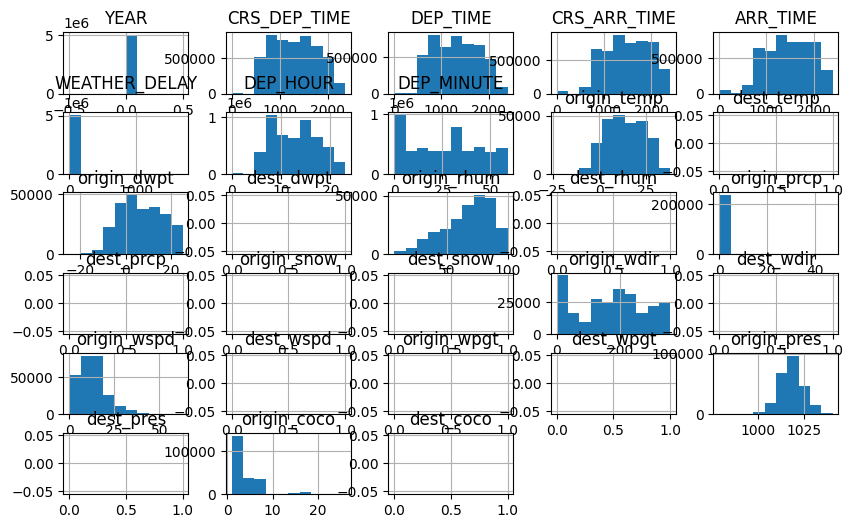

In [7]:

df.hist(figsize=(10, 6))

Look for correlations between variables using a heatmap:

<Axes: >

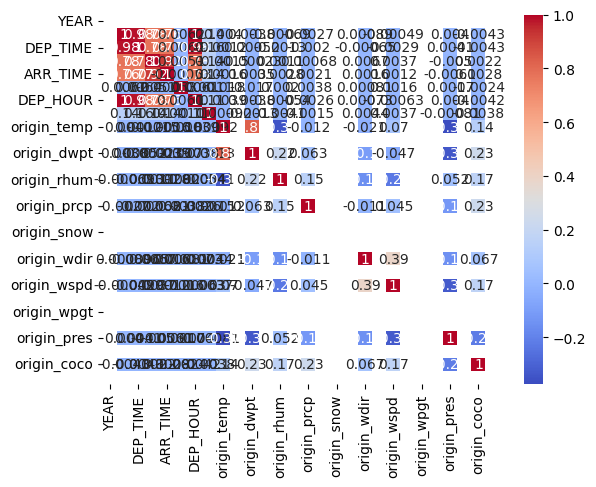

In [8]:

sns.heatmap(df.corr( numeric_only=True), annot=True, cmap="coolwarm") 

## Data Profiling with `ydata-profiling`

As an alternative to manual analysis above, `ydata-profiling` can be used to generate a comprehensive profiling report and even flag potential issues with our data. `ydata-profiling` can write the report to a file (`to_file()`) or display in a notebook (`to_widgets()`).

In this example, we'll work with a sample of 10,000 records.

Generate the report (it may take a few minutes) and display as JupyterLab widget. Inspect the report including:
 * Overview statistics and alerts
 * Variable level statistics, distributions, and type detection
 * Correlations (heatmap)
 * Missing values 

 **Note**: If the widget doesn't display, inspect the `ydata-profile.html` report.

In [10]:

sample = df.sample(10000)
ydata_profile = ProfileReport(sample, title="YData Profiling Report")
ydata_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 32/32 [00:00<00:00, 15927.11it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

While `ydata-profiling` is more commonly used for its interactive reports, it is possible to access the underlying data.

Use the JSON output to inspect the inferred data types and compare to Pandas above. `ydata-profiline` correctly detects the datetime format for `Inspection Date` and categorical for `Risk` and `Results` (among others). Note that `Categorical` relates directly to the Pandas `Categorical` data type.

In [11]:
# Read local file
# with open("ydata-profile.json", "r") as file:
#    json_data = json.load(file)

json_data = json.loads(ydata_profile.to_json())

for variable in json_data['variables'].keys():
    print(f"{variable}, {json_data['variables'][variable]['type']}")

Render JSON:   0%|          | 0/1 [00:00<?, ?it/s]

YEAR, Categorical
FL_DATE, DateTime
ORIGIN, Text
DEST, Text
CRS_DEP_TIME, Numeric
DEP_TIME, Numeric
CRS_ARR_TIME, Numeric
ARR_TIME, Numeric
WEATHER_DELAY, Numeric
DEP_HOUR, Numeric
DEP_MINUTE, Numeric
DEP_DATETIME, DateTime
origin_temp, Numeric
dest_temp, Unsupported
origin_dwpt, Numeric
dest_dwpt, Unsupported
origin_rhum, Numeric
dest_rhum, Unsupported
origin_prcp, Numeric
dest_prcp, Unsupported
origin_snow, Unsupported
dest_snow, Unsupported
origin_wdir, Numeric
dest_wdir, Unsupported
origin_wspd, Numeric
dest_wspd, Unsupported
origin_wpgt, Unsupported
dest_wpgt, Unsupported
origin_pres, Numeric
dest_pres, Unsupported
origin_coco, Numeric
dest_coco, Unsupported


Use the JSON output to inspect the data quality alerts:

In [12]:
for alert in json_data['alerts']: 
    print(alert)

[YEAR] has a constant value
[ARR_TIME] is highly overall correlated with [CRS_ARR_TIME] and 3 other fields
[CRS_ARR_TIME] is highly overall correlated with [ARR_TIME] and 3 other fields
[CRS_DEP_TIME] is highly overall correlated with [ARR_TIME] and 3 other fields
[DEP_HOUR] is highly overall correlated with [ARR_TIME] and 3 other fields
[DEP_TIME] is highly overall correlated with [ARR_TIME] and 3 other fields
[origin_dwpt] is highly overall correlated with [origin_temp]
[origin_temp] is highly overall correlated with [origin_dwpt]
[DEP_TIME] 596 (6.0%) missing values
[ARR_TIME] 601 (6.0%) missing values
[origin_temp] 9476 (94.8%) missing values
[dest_temp] 10000 (100.0%) missing values
[origin_dwpt] 9476 (94.8%) missing values
[dest_dwpt] 10000 (100.0%) missing values
[origin_rhum] 9476 (94.8%) missing values
[dest_rhum] 10000 (100.0%) missing values
[origin_prcp] 9524 (95.2%) missing values
[dest_prcp] 10000 (100.0%) missing values
[origin_snow] 10000 (100.0%) missing values
[dest_s

In summary, `ydata-profiling` includes notable features over basic Pandas profiling:
* Comprehensive report with dataset and variable-level statistics, correlation plots, and missing value summaries.
* [Data type inference](https://docs.profiling.ydata.ai/latest/getting-started/concepts/#data-types) including categorical, date/datetime, time-series, URL, and paths.
* Ability to detect and notify users about a [number of potential quality issues](https://docs.profiling.ydata.ai/latest/getting-started/concepts/#data-quality-alerts).

Some features, such as outlier and PII detection, are limited to the YData Fabric cloud service.


## DataProfiler

[DataProfiler](https://capitalone.github.io/DataProfiler/) similarly generates summary information about a dataset. Unlike `ydata-profiling`, DataProfiler is non-interactive--reports are Python dictionaries intended to be used programmatically.

DataProfiler supports detection of a wider variety of [data types](https://capitalone.github.io/DataProfiler/docs/0.12.0/html/index.html#data-labels) including potential PII.

In [13]:
profiler = Profiler(sample)
profile_report = profiler.report()

c:\Users\yeyuc\Documents\CS513\CS513_Final_Proj\.venv\lib\site-packages\keras\src\saving\saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 48 variables whereas the saved optimizer has 2 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


INFO:DataProfiler.profilers.profile_builder: Finding the Null values in the columns...  (with 31 processes)


c:\Users\yeyuc\Documents\CS513\CS513_Final_Proj\.venv\lib\site-packages\dataprofiler\profilers\profile_builder.py:2903: UserWarning: The data will be profiled with a sample size of 5000. All statistics will be based on this subsample and not the whole dataset.
  warnings.warn(
100%|██████████| 32/32 [00:16<00:00,  1.92it/s]


INFO:DataProfiler.profilers.profile_builder: Calculating the statistics...  (with 4 processes)


100%|██████████| 32/32 [00:03<00:00,  9.62it/s]
c:\Users\yeyuc\Documents\CS513\CS513_Final_Proj\.venv\lib\site-packages\dataprofiler\profilers\profiler_utils.py:752: RuntimeWarning: Insufficient number of categories. Chi-squared test cannot be performed.
  warnings.warn(


Output the profile data to a JSON file for inspection:

In [14]:
report  = profiler.report(report_options={"output_format": "pretty"})
with open("dataprofiler-report.json", "w") as f:
    f.write(json.dumps(report, indent=4))

Use the DataProfiler report to look at inferred `data_type`, `data_label`, and `categorical` values. Compare to Pandas and `ydata-profiling`:

In [15]:
for col in profile_report["data_stats"]:
    print(f"{col['column_name'], col['data_type'], col['data_label'], col['categorical']}")

('YEAR', 'int', 'INTEGER', True)
('FL_DATE', 'datetime', 'DATE', True)
('ORIGIN', 'string', 'UNKNOWN', True)
('DEST', 'string', 'UNKNOWN', True)
('CRS_DEP_TIME', 'int', 'INTEGER', True)
('DEP_TIME', 'int', 'FLOAT', False)
('CRS_ARR_TIME', 'int', 'INTEGER', False)
('ARR_TIME', 'int', 'FLOAT', False)
('WEATHER_DELAY', 'int', 'ORDINAL', True)
('DEP_HOUR', 'int', 'INTEGER', True)
('DEP_MINUTE', 'int', 'INTEGER', True)
('DEP_DATETIME', 'datetime', 'DATETIME', False)
('origin_temp', 'float', 'FLOAT', False)
('dest_temp', None, None, True)
('origin_dwpt', 'float', 'FLOAT', False)
('dest_dwpt', None, None, True)
('origin_rhum', 'int', 'FLOAT', False)
('dest_rhum', None, None, True)
('origin_prcp', 'float', 'ORDINAL', True)
('dest_prcp', None, None, True)
('origin_snow', None, None, True)
('dest_snow', None, None, True)
('origin_wdir', 'int', 'FLOAT', True)
('dest_wdir', None, None, True)
('origin_wspd', 'float', 'FLOAT', True)
('dest_wspd', None, None, True)
('origin_wpgt', None, None, True)
(

DataProfiler includes a different set of basic inferred types including datatime and distinguishing `int` and `float` as well as `string` and `text` values. DataProfiler also identifies potential PII (e.g., the `DRIVERS_LICENSE` and `ADDRESS` labels). Finally, it also correctly identifies categorical variables.

DataProfiler supports many of the features of `ydata-profiler` in a programmatic interface. It additionally supports data type inference and classification for more data types, including sensitive information.

## Key Takeaways
* Basic Pandas functions can be used for data profiling, but more advanced features are available in third-party libraries.
* `ydata-profiling` is a widely-used profiling tool that generates a comprehensive and understandable report. It includes a number of features including semantic type detection and automatic alerts for potential data quality issues.
* `dataprofiler`includes additional support for data types including PII.
